In [1]:
#import libraries

import pandas as pd
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import matplotlib
plt.style.use('ggplot')
from matplotlib.pyplot import figure

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (12,8)

# Read in the data
df = pd.read_csv(r'C:\Users\Goku9\Documents\Data Analyst Projects\MOVIE PROJECT\movies.csv')

In [5]:
df

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000.0,46998772.0,Warner Bros.,146.0
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000.0,58853106.0,Columbia Pictures,104.0
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000.0,538375067.0,Lucasfilm,124.0
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000.0,83453539.0,Paramount Pictures,88.0
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000.0,39846344.0,Orion Pictures,98.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7663,More to Life,NaN,Drama,2020,"October 23, 2020 (United States)",3.1,18.0,Joseph Ebanks,Joseph Ebanks,Shannon Bond,United States,7000.0,NaN,NaN,90.0
7664,Dream Round,NaN,Comedy,2020,"February 7, 2020 (United States)",4.7,36.0,Dusty Dukatz,Lisa Huston,Michael Saquella,United States,NaN,NaN,Cactus Blue Entertainment,90.0
7665,Saving Mbango,NaN,Drama,2020,"April 27, 2020 (Cameroon)",5.7,29.0,Nkanya Nkwai,Lynno Lovert,Onyama Laura,United States,58750.0,NaN,Embi Productions,NaN
7666,It's Just Us,NaN,Drama,2020,"October 1, 2020 (United States)",NaN,NaN,James Randall,James Randall,Christina Roz,United States,15000.0,NaN,NaN,120.0


In [7]:
# Check for missing data

for col in df.columns:
    pct_missing = np.mean(df[col].isnull())
    print('{} - {}%'.format(col, pct_missing*100))

name - 0.0%
rating - 1.004173187271779%
genre - 0.0%
year - 0.0%
released - 0.02608242044861763%
score - 0.03912363067292645%
votes - 0.03912363067292645%
director - 0.0%
writer - 0.03912363067292645%
star - 0.013041210224308816%
country - 0.03912363067292645%
budget - 28.31246739697444%
gross - 2.464788732394366%
company - 0.2217005738132499%
runtime - 0.05216484089723526%


In [8]:
# Data types for columns

df.dtypes

name         object
rating       object
genre        object
year          int64
released     object
score       float64
votes       float64
director     object
writer       object
star         object
country      object
budget      float64
gross       float64
company      object
runtime     float64
dtype: object

In [ ]:
# Data cleaning and sorting before using the data

In [44]:
# Converting data types to drop leading 0

df['budget'] = pd.to_numeric(df['budget'], errors='coerce').fillna(0).astype(int)

df['gross'] = pd.to_numeric(df['gross'], errors='coerce').fillna(0).astype(int)

In [38]:
#Create correct year column to fix incorrect dates

df['yearcorrect'] = df['released'].astype(str).str.split().str[2]


In [63]:
# Sorting from highest to lowest on profit

df.sort_values(by=['gross'], inplace=False, ascending=False)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,yearcorrect
6663,5072,5,0,2015,686,7.8,876000.0,1105,2517,505,55,245000000,2069521700,1502,138.0,37
7244,528,5,0,2018,185,8.4,897000.0,160,729,2189,55,321000000,2048359754,1568,149.0,40
7480,6109,4,2,2019,1464,6.9,222000.0,1430,1894,654,55,260000000,1670727580,2266,118.0,41
6653,2936,5,0,2015,1680,7.0,593000.0,507,3521,421,55,150000000,1670516444,2232,124.0,37
6043,5422,5,0,2012,2440,8.0,1300000.0,1491,2285,2189,55,220000000,1518815515,1568,143.0,34
6646,2121,5,0,2015,213,7.1,370000.0,1167,693,2660,55,190000000,1515341399,2232,137.0,37
7494,2107,4,2,2019,2640,6.8,148000.0,425,1925,1490,55,150000000,1450026933,2265,103.0,41
6644,527,5,0,2015,2205,7.3,777000.0,1491,2285,2189,55,250000000,1402809540,1568,141.0,37
7247,780,5,0,2018,941,7.3,661000.0,2414,3746,372,55,200000000,1347597973,1568,134.0,40
5845,2380,5,1,2011,1421,8.1,790000.0,665,3995,533,54,125000000,1342321665,2269,130.0,33


In [42]:
# drop nulls and duplicates 
df = df.dropna()

df.drop_duplicates()

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,yearcorrect
0,The Shining,R,Drama,1980,"June 13, 1980 (United States)",8.4,927000.0,Stanley Kubrick,Stephen King,Jack Nicholson,United Kingdom,19000000,46998772,Warner Bros.,146.0,1980
1,The Blue Lagoon,R,Adventure,1980,"July 2, 1980 (United States)",5.8,65000.0,Randal Kleiser,Henry De Vere Stacpoole,Brooke Shields,United States,4500000,58853106,Columbia Pictures,104.0,1980
2,Star Wars: Episode V - The Empire Strikes Back,PG,Action,1980,"June 20, 1980 (United States)",8.7,1200000.0,Irvin Kershner,Leigh Brackett,Mark Hamill,United States,18000000,538375067,Lucasfilm,124.0,1980
3,Airplane!,PG,Comedy,1980,"July 2, 1980 (United States)",7.7,221000.0,Jim Abrahams,Jim Abrahams,Robert Hays,United States,3500000,83453539,Paramount Pictures,88.0,1980
4,Caddyshack,R,Comedy,1980,"July 25, 1980 (United States)",7.3,108000.0,Harold Ramis,Brian Doyle-Murray,Chevy Chase,United States,6000000,39846344,Orion Pictures,98.0,1980
5,Friday the 13th,R,Horror,1980,"May 9, 1980 (United States)",6.4,123000.0,Sean S. Cunningham,Victor Miller,Betsy Palmer,United States,550000,39754601,Paramount Pictures,95.0,1980
6,The Blues Brothers,R,Action,1980,"June 20, 1980 (United States)",7.9,188000.0,John Landis,Dan Aykroyd,John Belushi,United States,27000000,115229890,Universal Pictures,133.0,1980
7,Raging Bull,R,Biography,1980,"December 19, 1980 (United States)",8.2,330000.0,Martin Scorsese,Jake LaMotta,Robert De Niro,United States,18000000,23402427,Chartoff-Winkler Productions,129.0,1980
8,Superman II,PG,Action,1980,"June 19, 1981 (United States)",6.8,101000.0,Richard Lester,Jerry Siegel,Gene Hackman,United States,54000000,108185706,Dovemead Films,127.0,1981
9,The Long Riders,R,Biography,1980,"May 16, 1980 (United States)",7.0,10000.0,Walter Hill,Bill Bryden,David Carradine,United States,10000000,15795189,United Artists,100.0,1980


<Axes: >

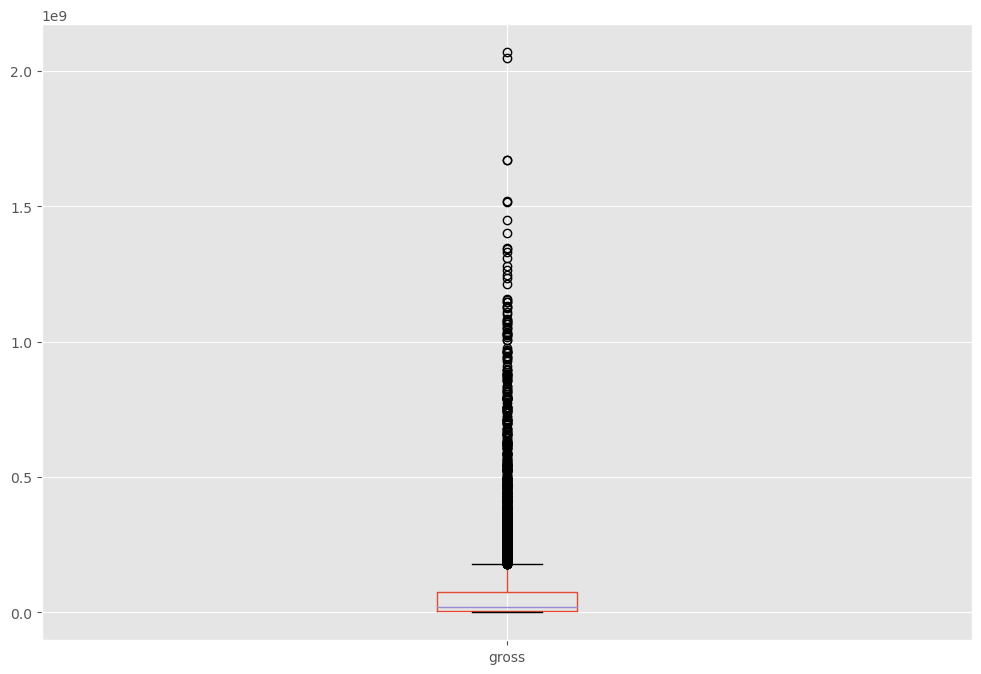

In [72]:
# Outlier check
df.boxplot(column=['gross'])

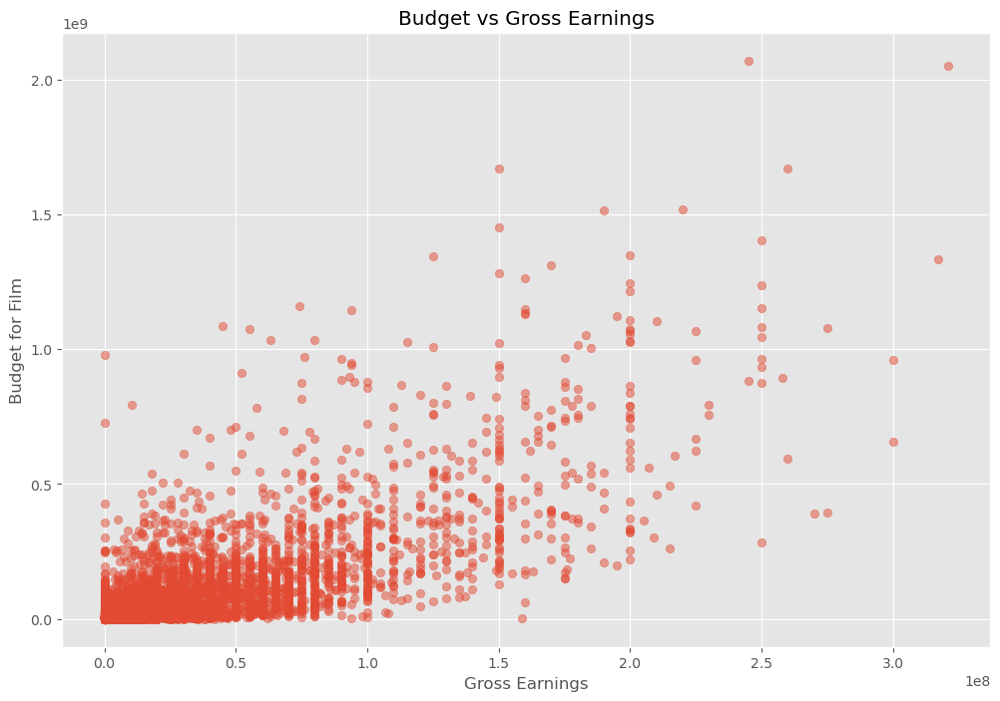

In [51]:
# Creating a scatterplot to show correlation between budget vs gross


plt.scatter(x=df['budget'], y=df['gross'], alpha=0.5)
plt.title('Budget vs Gross Earnings')
plt.xlabel('Gross Earnings')
plt.ylabel('Budget for Film')
plt.show()

<Axes: xlabel='budget', ylabel='gross'>

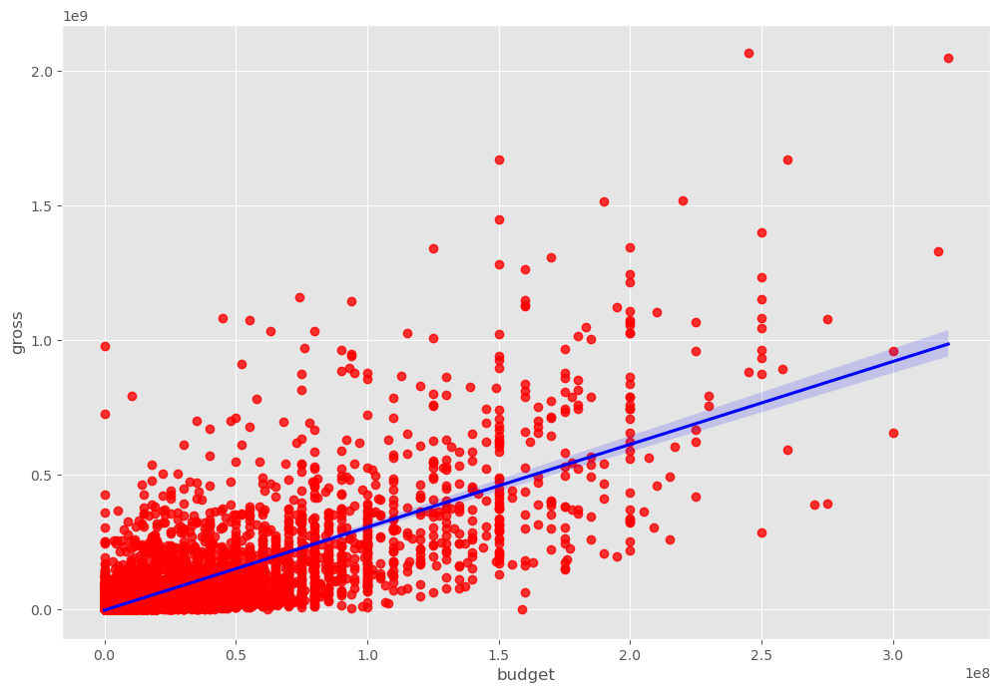

In [56]:
# Plot budget vs gross using seaborn

sns.regplot(x='budget', y='gross', data=df, scatter_kws={"color": "red"}, line_kws={"color":"blue"})

In [ ]:
# Looking at correlation

In [59]:
df.corr(numeric_only=True)

,year,score,votes,budget,gross,runtime
year,1.000000,0.102390,0.226767,0.315053,0.273088,0.120145
score,0.102390,1.000000,0.411612,0.053361,0.187581,0.399830
votes,0.226767,0.411612,1.000000,0.478590,0.632845,0.303520
budget,0.315053,0.053361,0.478590,1.000000,0.754866,0.263606
gross,0.273088,0.187581,0.632845,0.754866,1.000000,0.233902
runtime,0.120145,0.399830,0.303520,0.263606,0.233902,1.000000


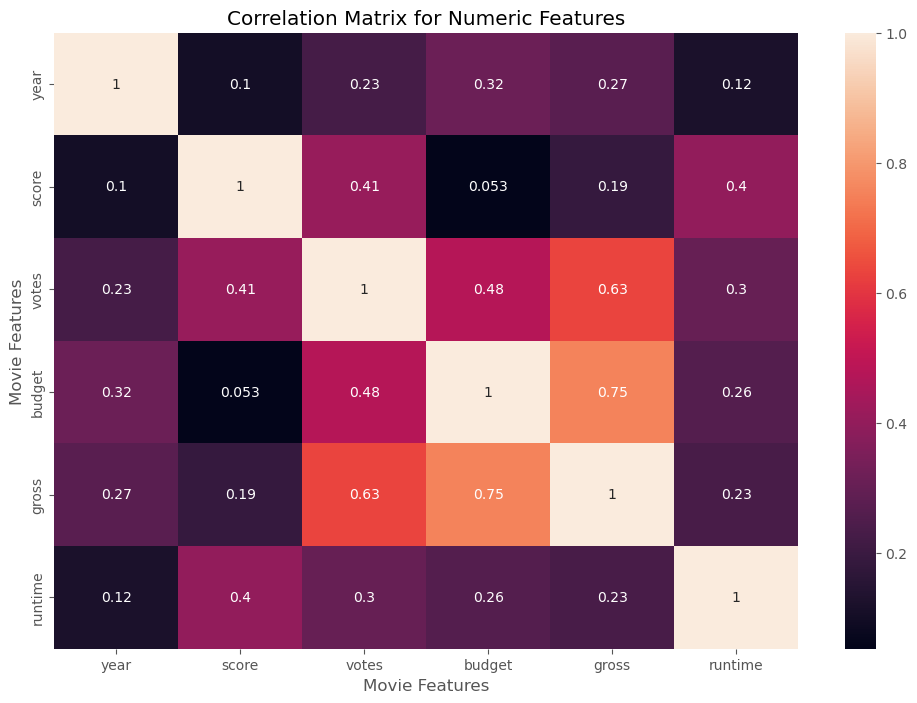

In [61]:
# Shows high correlation between budget and gross

correlation_matrix = df.corr(numeric_only=True)

sns.heatmap(correlation_matrix, annot=True)
plt.title('Correlation Matrix for Numeric Features')
plt.xlabel('Movie Features')
plt.ylabel('Movie Features')
plt.show()

In [64]:
#correlation between companies

df_numerized = df

for col_name in df_numerized.columns:
    if(df_numerized[col_name].dtype == 'object'):
        df_numerized[col_name]= df_numerized[col_name].astype('category')
        df_numerized[col_name] = df_numerized[col_name].cat.codes
        
df_numerized

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,yearcorrect
0,6501,6,6,1980,1681,8.4,927000.0,2541,3957,1019,54,19000000,46998772,2269,146.0,2
1,5493,6,1,1980,1468,5.8,65000.0,2230,1611,314,55,4500000,58853106,709,104.0,2
2,5070,4,0,1980,1747,8.7,1200000.0,1091,2533,1705,55,18000000,538375067,1502,124.0,2
3,282,4,4,1980,1468,7.7,221000.0,1276,1974,2194,55,3500000,83453539,1765,88.0,2
4,1014,6,4,1980,1519,7.3,108000.0,1035,511,396,55,6000000,39846344,1732,98.0,2
5,2085,6,9,1980,2470,6.4,123000.0,2483,4302,232,55,550000,39754601,1765,95.0,2
6,5494,6,0,1980,1747,7.9,188000.0,1387,821,1247,55,27000000,115229890,2232,133.0,2
7,4371,6,3,1980,687,8.2,330000.0,1796,1746,2188,55,18000000,23402427,611,129.0,2
8,5206,4,0,1980,1729,6.8,101000.0,2264,1954,852,55,54000000,108185706,860,127.0,3
9,6128,6,3,1980,2256,7.0,10000.0,2813,413,569,55,10000000,15795189,2223,100.0,2


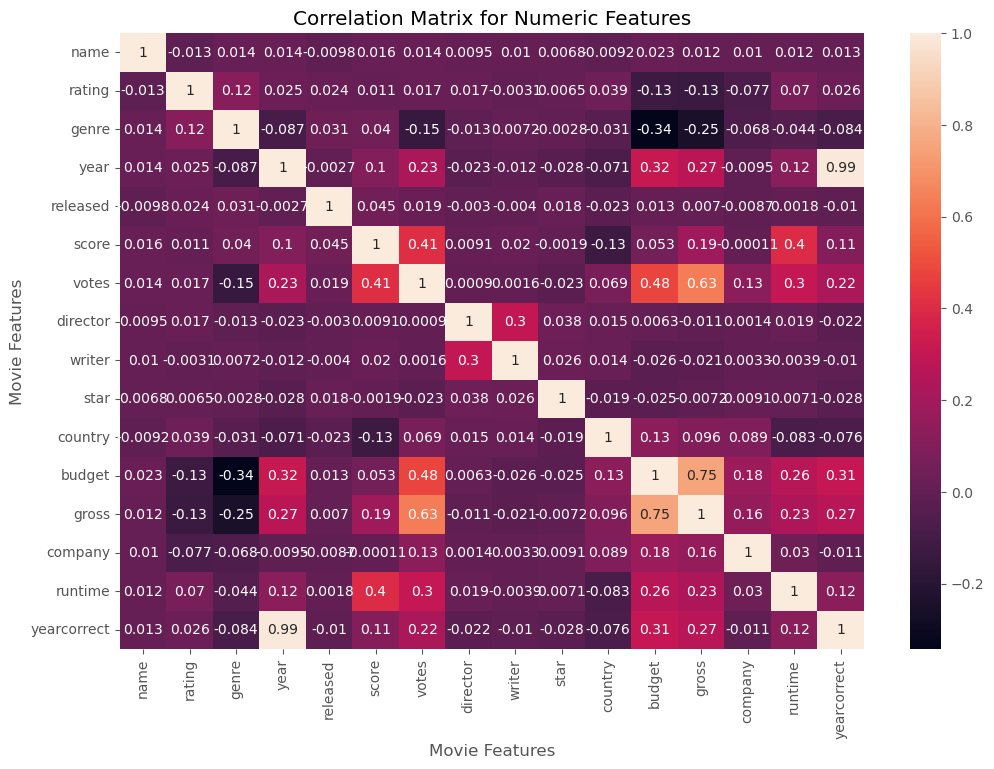

In [65]:
correlation_matrix = df_numerized.corr(numeric_only=True)

sns.heatmap(correlation_matrix, annot=True)
plt.title('Correlation Matrix for Numeric Features')
plt.xlabel('Movie Features')
plt.ylabel('Movie Features')
plt.show()

In [68]:
df_numerized.corr(numeric_only=True)

,name,rating,genre,year,released,score,votes,director,writer,star,country,budget,gross,company,runtime,yearcorrect
name,1.000000,-0.012595,0.014363,0.014197,-0.009777,0.016094,0.014428,0.009482,0.010285,0.006772,-0.009239,0.023133,0.011590,0.010154,0.011851,0.013305
rating,-0.012595,1.000000,0.117748,0.024651,0.024342,0.011420,0.016614,0.016928,-0.003139,0.006531,0.038543,-0.127563,-0.134623,-0.076894,0.070468,0.026028
genre,0.014363,0.117748,1.000000,-0.087250,0.031181,0.040143,-0.148000,-0.013439,0.007181,-0.002757,-0.030913,-0.342833,-0.248558,-0.068406,-0.044022,-0.084313
year,0.014197,0.024651,-0.087250,1.000000,-0.002698,0.102390,0.226767,-0.022886,-0.011868,-0.028317,-0.070852,0.315053,0.273088,-0.009531,0.120145,0.991920
released,-0.009777,0.024342,0.031181,-0.002698,1.000000,0.044918,0.019192,-0.003016,-0.004019,0.017693,-0.022891,0.012642,0.007042,-0.008685,0.001767,-0.010214
score,0.016094,0.011420,0.040143,0.102390,0.044918,1.000000,0.411612,0.009093,0.019770,-0.001877,-0.129764,0.053361,0.187581,-0.000107,0.399830,0.107522
votes,0.014428,0.016614,-0.148000,0.226767,0.019192,0.411612,1.000000,0.000899,0.001580,-0.023163,0.068829,0.478590,0.632845,0.128320,0.303520,0.222514
director,0.009482,0.016928,-0.013439,-0.022886,-0.003016,0.009093,0.000899,1.000000,0.297456,0.037530,0.014901,0.006319,-0.010610,0.001363,0.018676,-0.021582
writer,0.010285,-0.003139,0.007181,-0.011868,-0.004019,0.019770,0.001580,0.297456,1.000000,0.026478,0.014383,-0.025574,-0.020753,0.003303,-0.003945,-0.010229
star,0.006772,0.006531,-0.002757,-0.028317,0.017693,-0.001877,-0.023163,0.037530,0.026478,1.000000,-0.018873,-0.024612,-0.007192,0.009118,0.007145,-0.027522


In [69]:
correlation_mat = df_numerized.corr(numeric_only=True)

corr_pairs = correlation_mat.unstack()

corr_pairs

name         name           1.000000
             rating        -0.012595
             genre          0.014363
             year           0.014197
             released      -0.009777
             score          0.016094
             votes          0.014428
             director       0.009482
             writer         0.010285
             star           0.006772
             country       -0.009239
             budget         0.023133
             gross          0.011590
             company        0.010154
             runtime        0.011851
             yearcorrect    0.013305
rating       name          -0.012595
             rating         1.000000
             genre          0.117748
             year           0.024651
             released       0.024342
             score          0.011420
             votes          0.016614
             director       0.016928
             writer        -0.003139
             star           0.006531
             country        0.038543
 

In [70]:
sorted_pairs = corr_pairs.sort_values()

sorted_pairs

budget       genre         -0.342833
genre        budget        -0.342833
             gross         -0.248558
gross        genre         -0.248558
votes        genre         -0.148000
genre        votes         -0.148000
rating       gross         -0.134623
gross        rating        -0.134623
country      score         -0.129764
score        country       -0.129764
budget       rating        -0.127563
rating       budget        -0.127563
genre        year          -0.087250
year         genre         -0.087250
yearcorrect  genre         -0.084313
genre        yearcorrect   -0.084313
runtime      country       -0.082882
country      runtime       -0.082882
company      rating        -0.076894
rating       company       -0.076894
country      yearcorrect   -0.075580
yearcorrect  country       -0.075580
country      year          -0.070852
year         country       -0.070852
genre        company       -0.068406
company      genre         -0.068406
genre        runtime       -0.044022
r

In [71]:
high_corr = sorted_pairs[(sorted_pairs) > 0.5]

high_corr

votes        gross          0.632845
gross        votes          0.632845
budget       gross          0.754866
gross        budget         0.754866
yearcorrect  year           0.991920
year         yearcorrect    0.991920
name         name           1.000000
company      company        1.000000
gross        gross          1.000000
budget       budget         1.000000
country      country        1.000000
star         star           1.000000
writer       writer         1.000000
director     director       1.000000
votes        votes          1.000000
score        score          1.000000
released     released       1.000000
year         year           1.000000
genre        genre          1.000000
rating       rating         1.000000
runtime      runtime        1.000000
yearcorrect  yearcorrect    1.000000
dtype: float64

In [ ]:
# votes and budget hvae the highest correlation to gross earnings